In [114]:
import geopandas as gpd
import matplotlib.pyplot as plt

In [115]:
# Load the shapefile
shapefile_path = "NYC_WalkabilityIndex.shp"
gdf = gpd.read_file(shapefile_path)
gdf

,CTLabel,BoroCode,BoroName,CT2020,BoroCT2020,CDEligibil,NTAName,NTA2020,CDTA2020,CDTANAME,...,IDI_Scaled,GEOID_12_1,NDVI_Mean,NDVI_Scale,GEOID_12_2,Population,Pop_Densit,Pop_Dens_1,Walkabilit,geometry
0,1,1,Manhattan,000100,1000100,None,The Battery-Governors Island-Ellis Island-Libe...,MN0191,MN01,MN01 Financial District-Tribeca (CD 1 Equivalent),...,0.033206,36061000100,0.233677,0.445464,36061000100,0,0.000000,0.000000,1.366429,"MULTIPOLYGON (((972081.788 190733.467, 972184...."
1,2.01,1,Manhattan,000201,1000201,None,Chinatown-Two Bridges,MN0301,MN03,MN03 Lower East Side-Chinatown (CD 3 Equivalent),...,0.424847,36061000201,0.140224,0.323385,36061000201,2012,57688.618194,0.200425,1.847155,"POLYGON ((988548.218 197770.375, 987978.808 19..."
2,6,1,Manhattan,000600,1000600,None,Chinatown-Two Bridges,MN0301,MN03,MN03 Lower East Side-Chinatown (CD 3 Equivalent),...,0.323439,36061000600,0.218581,0.425744,36061000600,11616,125386.167285,0.435623,1.984241,"POLYGON ((986961.186 199553.643, 987206.139 19..."
3,14.01,1,Manhattan,001401,1001401,None,Lower East Side,MN0302,MN03,MN03 Lower East Side-Chinatown (CD 3 Equivalent),...,0.243302,36061001401,0.216576,0.423125,36061001401,3543,98172.687814,0.341077,1.938192,"POLYGON ((987475.017 200297.218, 987705.443 20..."
4,14.02,1,Manhattan,001402,1001402,None,Lower East Side,MN0302,MN03,MN03 Lower East Side-Chinatown (CD 3 Equivalent),...,0.558971,36061001402,0.097206,0.267191,36061001402,3418,77709.905945,0.269984,1.756519,"POLYGON ((988387.669 201258.311, 988621.002 20..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2320,176,5,Staten Island,017600,5017600,None,Annadale-Huguenot-Prince's Bay-Woodrow,SI0304,SI03,SI03 South Shore (CD 3 Approximation),...,0.060086,36085017600,0.466022,0.748978,36085017600,4932,3851.608090,0.013381,1.310940,"POLYGON ((939396.368 132182.901, 939532.522 13..."
2321,228.02,5,Staten Island,022802,5022802,None,Freshkills Park (North),SI0291,SI02,SI02 Mid-Island (CD 2 Approximation),...,0.016028,36085022802,0.336058,0.579206,36085022802,15,6.135759,0.000021,1.197282,"POLYGON ((937821.591 158672.978, 937700.899 15..."
2322,291.02,5,Staten Island,029102,5029102,None,New Springville-Willowbrook-Bulls Head-Travis,SI0204,SI02,SI02 Mid-Island (CD 2 Approximation),...,0.017282,36085029102,0.320910,0.559417,36085029102,3394,890.648358,0.003094,1.128676,"POLYGON ((937409.633 165643.463, 937393.891 16..."
2323,161,2,Bronx,016100,2016100,None,Crotona Park East,BX0303,BX03,BX03 Morrisania-Crotona Park East (CD 3 Approx...,...,0.175920,36005016100,0.117448,0.293633,36005016100,5243,56780.236869,0.197269,1.393486,"POLYGON ((1016899.335 244402.689, 1016891.875 ..."


In [116]:
gdf.columns

Index(['CTLabel', 'BoroCode', 'BoroName', 'CT2020', 'BoroCT2020', 'CDEligibil',
       'NTAName', 'NTA2020', 'CDTA2020', 'CDTANAME', 'GEOID', 'PUMA',
       'Shape_Leng', 'State', 'Area', 'Entropy', 'LUDI_Scale', 'Shape_Le_1',
       'Shape_Area', 'Join_Count', 'GEOID_1', 'PTAI', 'PTAI_Scale', 'GEOID_12',
       'IDI', 'IDI_Scaled', 'GEOID_12_1', 'NDVI_Mean', 'NDVI_Scale',
       'GEOID_12_2', 'Population', 'Pop_Densit', 'Pop_Dens_1', 'Walkabilit',
       'geometry'],
      dtype='object')

# Walkability Index Viz

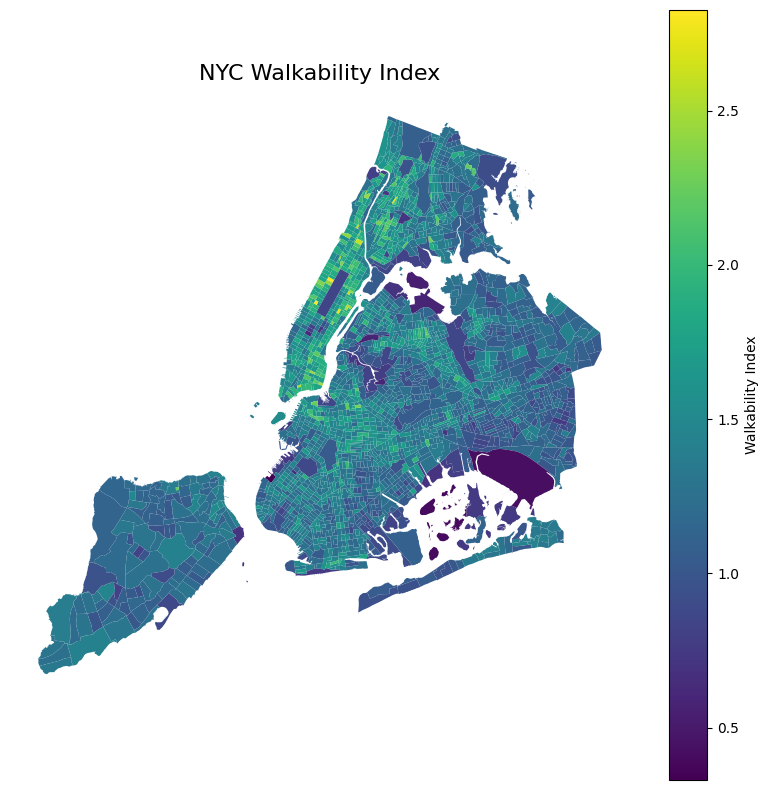

In [117]:
# Plot the WalkabilityIndex column as a choropleth map
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(
    column='Walkabilit',  # Replace with the exact column name if different
    cmap='viridis',            # Choose a colormap
    legend=True,               # Add a legend
    legend_kwds={'label': "Walkability Index"},
    ax=ax
)
ax.set_title("NYC Walkability Index", fontsize=16)
ax.axis('off')  # Turn off the axes for better visual
plt.show()


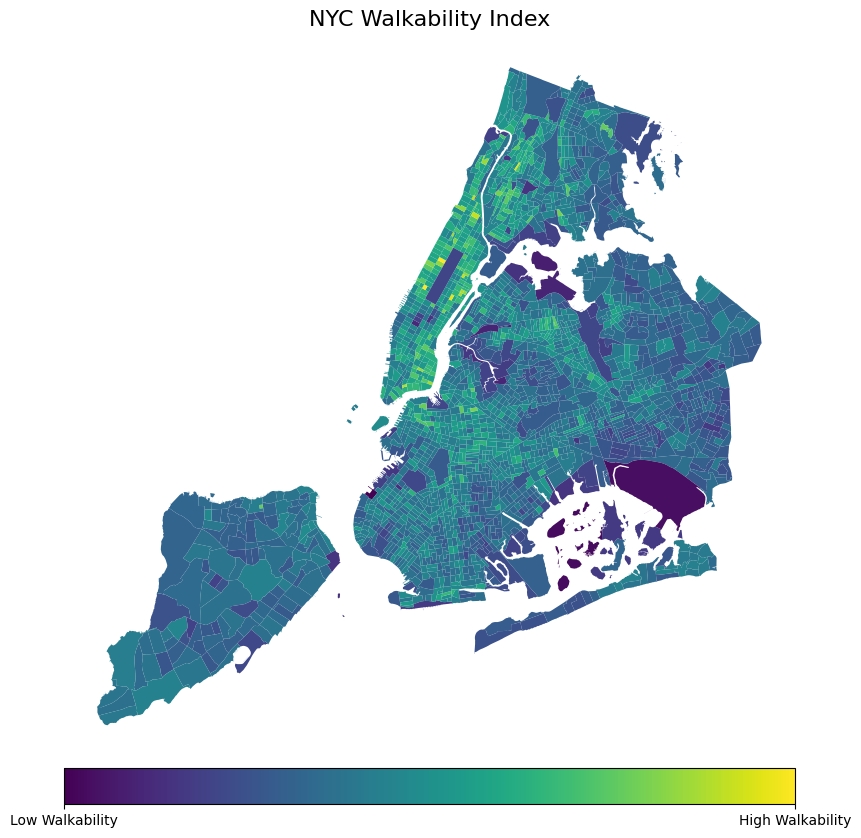

In [118]:
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Create the plot
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(
    column='Walkabilit',  # Use the exact column name
    cmap='viridis',       # Choose a colormap
    legend=False,         # Turn off the default legend
    ax=ax
)

# Add a horizontal colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes("bottom", size="5%", pad=0.1)
sm = plt.cm.ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=gdf['Walkabilit'].min(), vmax=gdf['Walkabilit'].max()))
cbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Set the colorbar ticks and labels
cbar.set_ticks([gdf['Walkabilit'].min(), gdf['Walkabilit'].max()])
cbar.set_ticklabels(["Low Walkability", "High Walkability"])

# Add a title and turn off the axes
ax.set_title("NYC Walkability Index", fontsize=16)
ax.axis('off')

plt.show()

In [119]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import requests
from matplotlib.font_manager import FontProperties

# Download custom fonts
title_font_url = "https://github.com/google/fonts/raw/main/ofl/merriweather/Merriweather-Regular.ttf"
footer_font_url = "https://github.com/google/fonts/raw/main/ofl/lato/Lato-Regular.ttf"
title_font_path = "Merriweather-Regular.ttf"
footer_font_path = "Lato-Regular.ttf"

# Download Title Font
with open(title_font_path, "wb") as file:
    file.write(requests.get(title_font_url).content)

# Download Lato Font
with open(footer_font_path, "wb") as file:
    file.write(requests.get(footer_font_url).content)

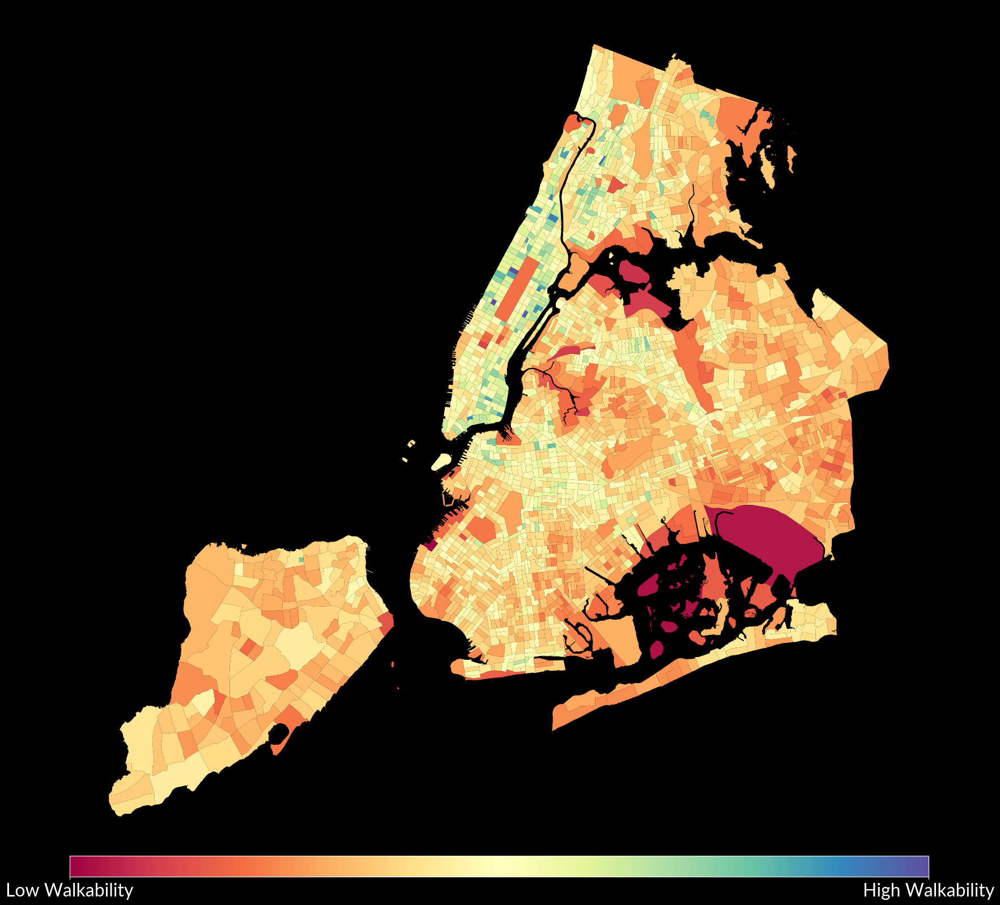

In [120]:
# Load fonts explicitly using FontProperties
title_font = FontProperties(fname=title_font_path, size=25)
lato_font = FontProperties(fname=footer_font_path, size=23)

# Create the plot
fig, ax = plt.subplots(figsize=(20, 20), facecolor="black")  # Set background color to black
gdf.plot(
    column='Walkabilit',  # Use the exact column name
    cmap='Spectral',       # Choose a colormap
    legend=False,         # Turn off the default legend
    ax=ax
)

# Add a horizontal colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes("bottom", size="2.5%", pad=0.01)  # Adjust padding and position
sm = plt.cm.ScalarMappable(cmap='Spectral', norm=plt.Normalize(vmin=gdf['Walkabilit'].min(), vmax=gdf['Walkabilit'].max()))
cbar = fig.colorbar(sm, cax=cax, orientation='horizontal', shrink=0.1, aspect=1)  # Adjust shrink and aspect

# Set the colorbar ticks and labels
cbar.set_ticks([gdf['Walkabilit'].min(), gdf['Walkabilit'].max()])
cbar.set_ticklabels(["Low Walkability", "High Walkability"], fontproperties=lato_font)
cbar.outline.set_edgecolor('white')  # Change colorbar outline to white
cbar.ax.xaxis.set_tick_params(color='white')  # Change tick color to white
plt.setp(cbar.ax.xaxis.get_ticklabels(), color='white')  # Change tick label color to white

# Add a title
# ax.set_title("NYC Walkability Index", fontsize=20, fontproperties=title_font, color="white")  # Title in white

# Turn off axes and set background to black
ax.axis('off')
ax.set_facecolor("black")  # Set the map's background to black

# Save the plot as PNG
output_filename = "1_WalkabilityIndex.png"
plt.savefig(output_filename, dpi=300, bbox_inches='tight', facecolor='black')

plt.show()

# Other Indices

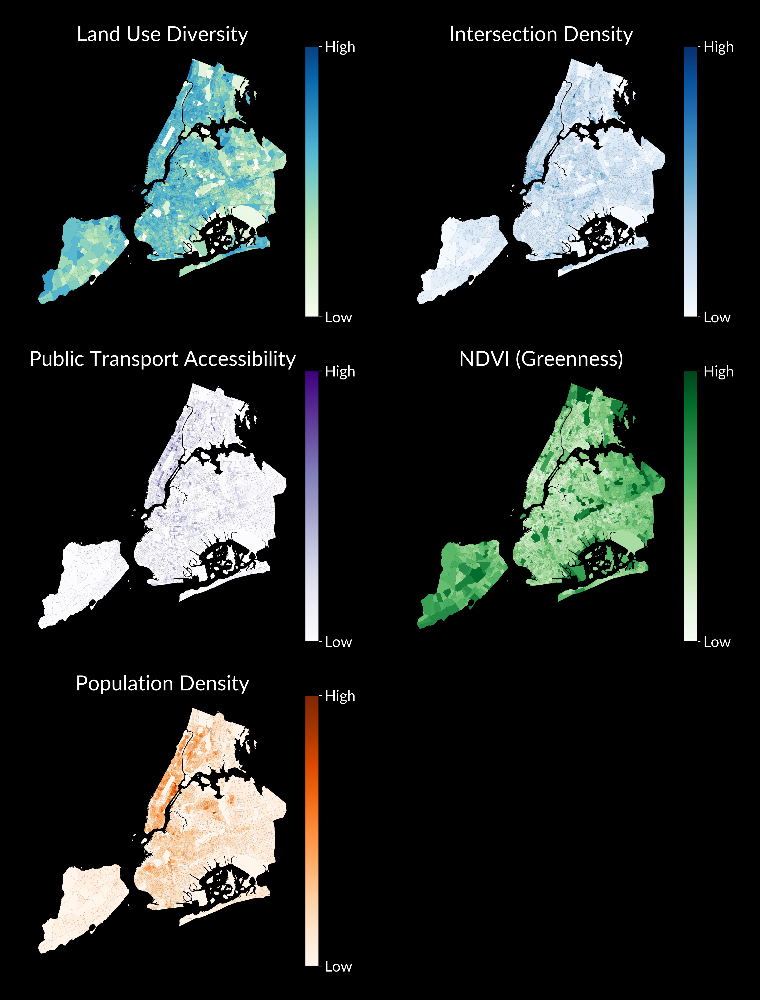

In [121]:
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.font_manager import FontProperties
from PIL import Image, ImageOps

# Load your GeoDataFrame
gdf = gpd.read_file("NYC_WalkabilityIndex.shp")

# Fonts for title and color bar
lato_font_title = FontProperties(fname="Lato-Regular.ttf", size=25)
lato_font_colorbar = FontProperties(fname="Lato-Regular.ttf", size=18)

# Define the index columns, their color maps, and titles
index_info = [
    ("LUDI_Scale", "GnBu", "Land Use Diversity"),  # Column 1
    ("IDI_Scaled", "Blues", "Intersection Density"),  # Column 1
    ("PTAI_Scale", "Purples", "Public Transport Accessibility"),  # Column 1
    ("NDVI_Scale", "Greens", "NDVI (Greenness)"),  # Column 2
    ("Pop_Dens_1", "Oranges", "Population Density")  # Column 2
]

# Create the figure and axes for subplots with adjusted spacing
fig, axes = plt.subplots(
    3, 2, figsize=(15, 20), gridspec_kw={"wspace": 0.2, "hspace": 0.2}, facecolor="black"
)

# Flatten axes for easier indexing
axes = axes.flatten()

# Loop through the index columns and plot each
for ax, (col, cmap, title) in zip(axes, index_info):
    # Create a divider for the axis to place the colorbar on the side
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)  # Colorbar on the right

    # Plot the GeoDataFrame
    gdf.plot(
        column=col,  # Column to plot
        cmap=cmap,  # Color scheme
        legend=False,  # Turn off default legend
        ax=ax
    )

    # Add the colorbar with only "Low" and "High" labels
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=gdf[col].min(), vmax=gdf[col].max()))
    cbar = fig.colorbar(sm, cax=cax)
    cbar.set_ticks([gdf[col].min(), gdf[col].max()])  # Only lowest and highest ticks
    cbar.set_ticklabels(["Low", "High"], fontproperties=lato_font_colorbar)  # Custom labels
    cbar.ax.yaxis.set_tick_params(color='white')  # Set tick colors to white
    plt.setp(cbar.ax.yaxis.get_ticklabels(), color="white")  # Set tick label colors to white

    # Style the axis
    ax.set_title(title, color="white", fontproperties=lato_font_title)  # Title in Lato font
    ax.set_axis_off()  # Turn off axes
    ax.set_facecolor("black")  # Set subplot background to black

# Remove unused subplot (6th one)
if len(index_info) < len(axes):
    for ax in axes[len(index_info):]:
        ax.remove()

# Save the plot as PNG
temp_filename = "temp_plot.png"
plt.savefig(temp_filename, dpi=300, bbox_inches='tight', facecolor='black')
plt.close(fig)

# Add padding around the entire image
with Image.open(temp_filename) as img:
    padded_img = ImageOps.expand(img, border=100, fill="black")  # Add 100px padding around the image
    padded_img.save("2_ContributingIndices.png")

# Show the final image
padded_img


# Final Viz

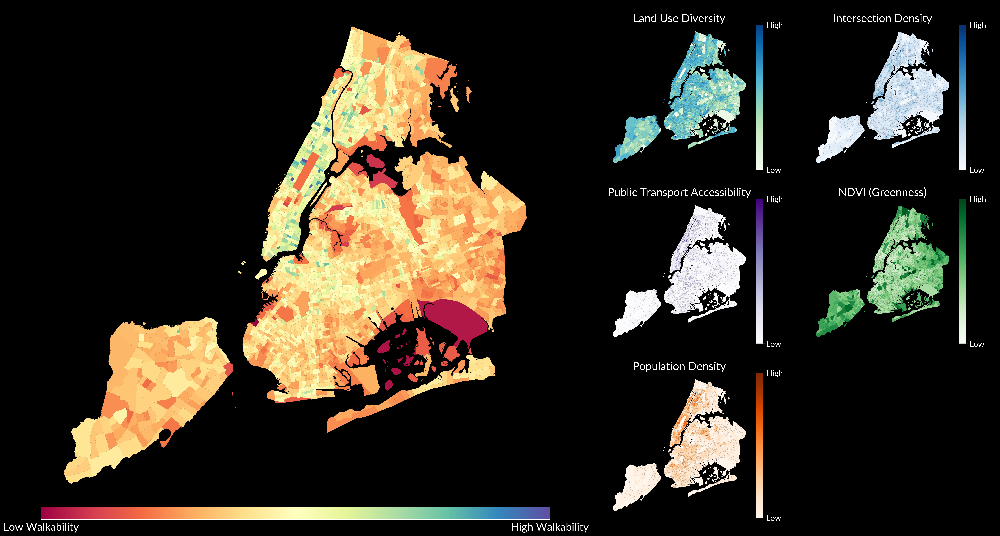

In [122]:
from PIL import Image

# Load the two images
image1 = Image.open("1_WalkabilityIndex.png")
image2 = Image.open("2_ContributingIndices.png")

# Ensure both images have the same height
if image1.size[1] != image2.size[1]:
    new_height = max(image1.size[1], image2.size[1])
    image1 = image1.resize((int(image1.size[0] * (new_height / image1.size[1])), new_height))
    image2 = image2.resize((int(image2.size[0] * (new_height / image2.size[1])), new_height))

# Combine the images side by side
combined_width = image1.size[0] + image2.size[0]
combined_height = image1.size[1]
combined_image = Image.new("RGB", (combined_width, combined_height), "black")
combined_image.paste(image1, (0, 0))
combined_image.paste(image2, (image1.size[0], 0))

# Save the combined image
combined_image.save("Combined_Walkability_Indices.png")

combined_image


In [146]:
from PIL import Image, ImageOps, ImageDraw, ImageFont

# Load the exported map image
filename = "Combined_Walkability_Indices.png"
map_image = Image.open(filename)

# Add padding to the image
padding = (300, 1000, 300, 300)  # (left, top, right, bottom)
padded_image = ImageOps.expand(map_image, border=padding, fill="black")

# Load fonts
title_font = ImageFont.truetype(title_font_path, size=250)
desc_font = ImageFont.truetype(footer_font_path, size=150)
footer_font = ImageFont.truetype(footer_font_path, size=75)

# Create a drawing context
draw = ImageDraw.Draw(padded_image)

# Add title
title_text = "Walkability Index New York City"
title_position = (padded_image.width // 2, 300)  # Centered in the top padding
draw.multiline_text(
    title_position,
    title_text,
    font=title_font,
    fill="white",
    anchor="mm",
    align="center",
)

# Add description below the title
description_text = (
    "This visualization shows the Walkability Index in NYC that incorporates five key indices: "
    "Land Use Diversity Index (LUDI), Intersection Density \nIndex (IDI), Public Transportation Accessibility "
    "Index (PTAI), Population Density Index (PDI), and Normalized Difference Vegetation Index (NDVI)."
)
description_position = (padded_image.width // 2, 650)  # Adjusted position below the title
draw.multiline_text(
    description_position,
    description_text,
    font=desc_font,
    fill="#CCCCCC",
    anchor="mm",
    align="center",
)

# Add footer
footer_text = ("Data: MapPLUTO, NYC Open Data, DCP, TIGER, Landsat"
               "\nProccesed and Analyzed using ArcGIS Pro, GEE, Python"
               "\n©2025 Godfried Junio Matahelemual"
               "\n#30DaysMapChallenge"
               "\nDay 17 - Collaborative Map (Collab with Ismail Rashad)")
footer_position = (padded_image.width - 400, padded_image.height - 800)  # Bottom-right corner with margin
draw.multiline_text(
    footer_position,
    footer_text,
    font=footer_font,
    fill="#777777",  # gray
    anchor="ra",  # Right-aligned
    align="right",
)

# Save the final annotated image
output_filename = "finalmap_" + filename
padded_image.save(output_filename)

padded_image
